In [1]:
import os
import math
import numpy as np
import tensorflow as tf

from PIL import Image
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import resize
from glob import glob

from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *

Matplotlib is building the font cache; this may take a moment.


In [2]:
IMAGE_SIZE=224

### Albumentations
- `Compose()` : 다양한 augmentation 기법을 확률적으로 적용

In [3]:
from albumentations import  HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

def build_augmentation(is_train=True):
  if is_train:
    # 훈련용 데이터일 경우
    return Compose([
        # 50%의 확률로 좌우대칭
        HorizontalFlip(p=0.5),
        # 50%의 확률로 RandomSizedCrop
        RandomSizedCrop(
            min_max_height=(300, 370),
            w2h_ratio=370/1242,
            height=IMAGE_SIZE,
            width=IMAGE_SIZE,
            p=0.5
            ),
        # 입력이미지를 224X224로 resize
        Resize(
            width=IMAGE_SIZE,
            height=IMAGE_SIZE
            )
        ])

  # 테스트용 데이터일 경우
  # 224X224로 resize만 수행
  return Compose([
                Resize(
                    width=IMAGE_SIZE,
                    height=IMAGE_SIZE
                    )
                ])

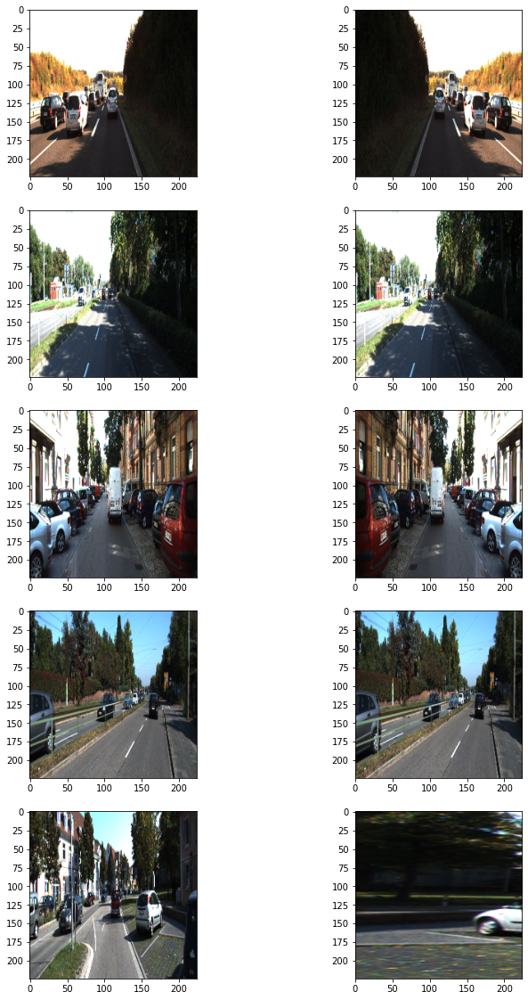

In [4]:
dir_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/data/training'

augmentation_train = build_augmentation()
augmentation_test = build_augmentation(is_train=False)
input_images = glob(os.path.join(dir_path, "image_2", "*.png"))

# 훈련 데이터셋에서 5개만 가져와 augmentation을 적용
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i]) 
    image_data = {"image":image}
    resized = augmentation_test(**image_data)
    processed = augmentation_train(**image_data)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  # 왼쪽이 원본이미지
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"])  # 오른쪽이 augment된 이미지
  
plt.show()

In [5]:
class KittiGenerator(tf.keras.utils.Sequence):
  '''
  KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
  우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
  '''
  def __init__(self, 
               dir_path,
               batch_size=1,
               img_size=(IMAGE_SIZE, IMAGE_SIZE, 3),
               output_size=(IMAGE_SIZE, IMAGE_SIZE),
               is_train=True,
               augmentation=None):
    '''
    dir_path: dataset의 directory path입니다.
    batch_size: batch_size입니다.
    img_size: preprocess에 사용할 입력이미지의 크기입니다.
    output_size: ground_truth를 만들어주기 위한 크기입니다.
    is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
    augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
    '''
    self.dir_path = dir_path
    self.batch_size = batch_size
    self.is_train = is_train
    self.dir_path = dir_path
    self.augmentation = augmentation
    self.img_size = img_size
    self.output_size = output_size

    # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
    self.data = self.load_dataset()

  def load_dataset(self):
    # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
    # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
    input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
    label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
    input_images.sort()
    label_images.sort()
    assert len(input_images) == len(label_images)
    data = [ _ for _ in zip(input_images, label_images)]

    if self.is_train:
      return data[:-30]
    return data[-30:]
    
  def __len__(self):
    # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
    return math.ceil(len(self.data) / self.batch_size)

  def __getitem__(self, index):
    # 입력과 출력을 만듭니다.
    # 입력은 resize및 augmentation이 적용된 input image이고 
    # 출력은 semantic label입니다.
    batch_data = self.data[
                           index*self.batch_size:
                           (index + 1)*self.batch_size
                           ]
    inputs = np.zeros([self.batch_size, *self.img_size])
    outputs = np.zeros([self.batch_size, *self.output_size])
        
    for i, data in enumerate(batch_data):
      input_img_path, output_path = data
      _input = imread(input_img_path)
      _output = imread(output_path)
      _output = (_output==7).astype(np.uint8)*1
      data = {
          "image": _input,
          "mask": _output,
          }
      augmented = self.augmentation(**data)
      inputs[i] = augmented["image"]/255
      outputs[i] = augmented["mask"]
    return inputs, outputs

  def on_epoch_end(self):
    # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
    self.indexes = np.arange(len(self.data))
    if self.is_train == True :
      np.random.shuffle(self.indexes)
      return self.indexes

In [6]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

### 시맨틱 세그멘테이션 모델
- U-Net 구현
- 입력 이미지의 크기 : 데이터셋에 맞게
- 사용에 필요한 레이어와 연산
  - Conv2D, Conv2DTranspose, MaxPooling2D, concatenate
  - 필요에 따라 Dropout 등 적용

In [7]:
def build_unet(input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)):
    inputs = Input(input_shape)

    #Contracting Path
    conv1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool4)  
    conv5 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv5)

    #Expanding Path
    drop5 = Dropout(0.5)(conv5)
    up6 = Conv2D(512, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(drop5)) 
    merge6 = concatenate([drop4,up6], axis = 3)
    conv6 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv6)
    up7 = Conv2D(256, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv6))
    merge7 = concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv7)
    up8 = Conv2D(128, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv7))
    merge8 = concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv8)
    up9 = Conv2D(64, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv8))
    merge9 = concatenate([conv1,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)  
    conv9 = Conv2D(2, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)     
    conv10 = Conv2D(1, 1, activation='sigmoid')(conv9)

    model = Model(inputs = inputs, outputs = conv10)
    return model

In [8]:
unet = build_unet()

In [10]:
unet.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 224, 224, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 224, 224, 64) 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 112, 112, 64) 0           conv2d_1[0][0]                   
______________________________________________________________________________________________

### 모델 학습

In [11]:
EPOCH=150
LEARNING_RATE=1e-4

In [13]:
unet_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/0314_seg_model_unet.h5'

unet.compile(optimizer = Adam(LEARNING_RATE), loss = 'binary_crossentropy')
unet_history = unet.fit(
     train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=EPOCH,
 )

unet.save(unet_path)

Epoch 1/150
170/170 [==============================] - 16s 86ms/step - loss: 0.4635 - val_loss: 0.3096
Epoch 2/150
170/170 [==============================] - 14s 84ms/step - loss: 0.2928 - val_loss: 0.2616
Epoch 3/150
170/170 [==============================] - 14s 84ms/step - loss: 0.2667 - val_loss: 0.2684
Epoch 4/150
170/170 [==============================] - 15s 86ms/step - loss: 0.2303 - val_loss: 0.2505
Epoch 5/150
170/170 [==============================] - 15s 87ms/step - loss: 0.2162 - val_loss: 0.2450
Epoch 6/150
170/170 [==============================] - 15s 88ms/step - loss: 0.2036 - val_loss: 0.2348
Epoch 7/150
170/170 [==============================] - 15s 88ms/step - loss: 0.1883 - val_loss: 0.3464
Epoch 8/150
170/170 [==============================] - 15s 89ms/step - loss: 0.1836 - val_loss: 0.2355
Epoch 9/150
170/170 [==============================] - 15s 87ms/step - loss: 0.1855 - val_loss: 0.2479
Epoch 10/150
170/170 [==============================] - 15s 87ms/step - l

In [14]:
import pandas as pd

def save_history_to_csv_path(history, csv_path):
    history_data = history.history
    df = pd.DataFrame(history_data)
    df.to_csv(csv_path, index=False)

In [15]:
def visualize_history(history, title):
    plt.figure(figsize=(12, 5))

    # Plot loss
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.plot(history.history['loss'], label='Training Loss')
    plt.title(f'{title} - Loss')
    plt.legend()

    plt.show()

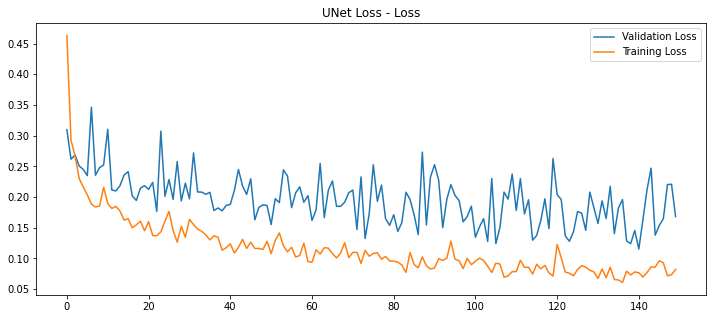

In [16]:
visualize_history(unet_history, "UNet Loss")

In [17]:
unet_history_csv_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/history/0314_unet_history.csv'
save_history_to_csv_path(unet_history, unet_history_csv_path)

## 모델 시각화

In [15]:
def calculate_iou_score(target, prediction):
    intersection = np.logical_and(target, prediction)
    union = np.logical_or(target, prediction)
    iou_score = float(np.sum(intersection)) / float(np.sum(union))
    print('IoU : %f' % iou_score )
    return iou_score

In [16]:
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    
    # predict
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    
    output = Image.blend(background, output, alpha=0.5)
    output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return output, prediction, target
    else:
        return output, prediction, _

In [17]:
def test(model, dataset):
    for i in range(1, 10):
        output, prediction, target = get_output(
            model, 
            dataset,
            image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
            output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
            label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
        )
        calculate_iou_score(target, prediction)

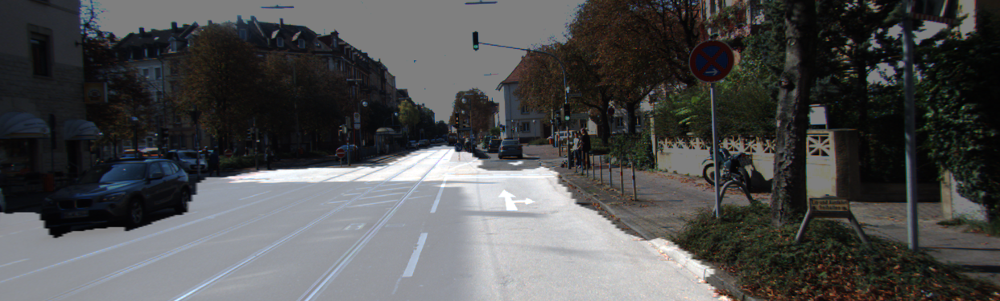

IoU : 0.946310


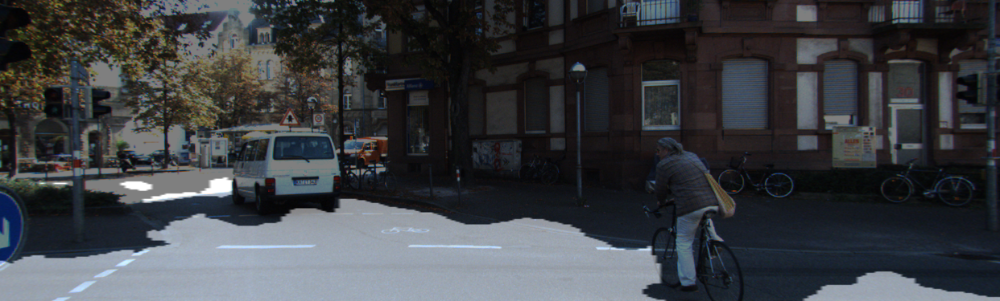

IoU : 0.704666


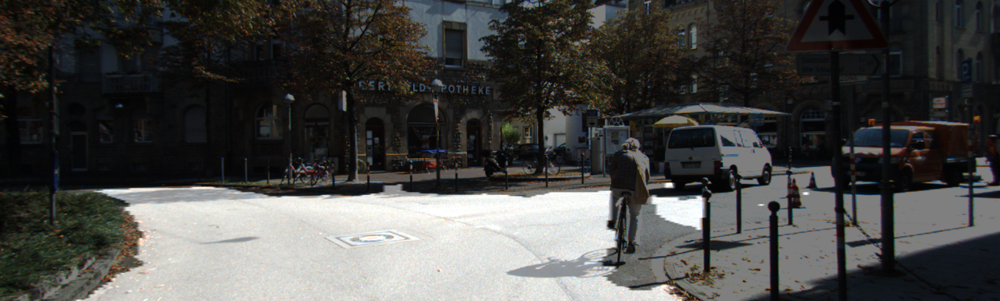

IoU : 0.814805


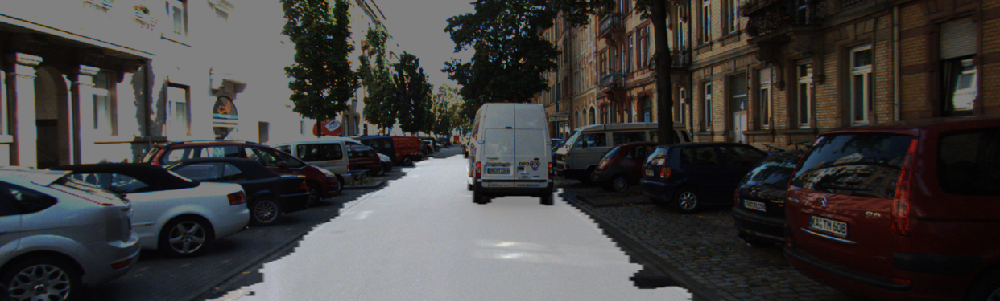

IoU : 0.912438


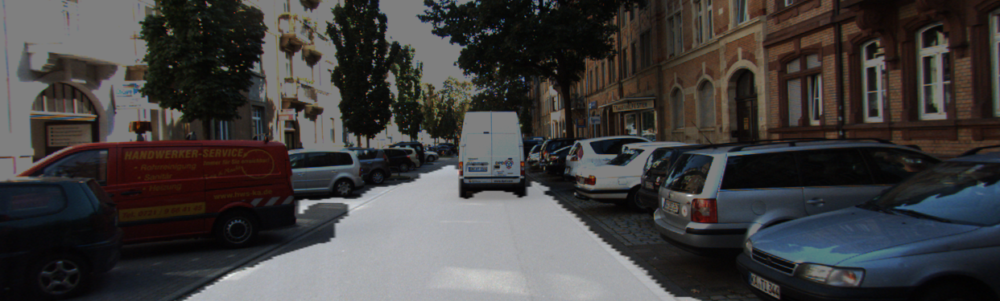

IoU : 0.925781


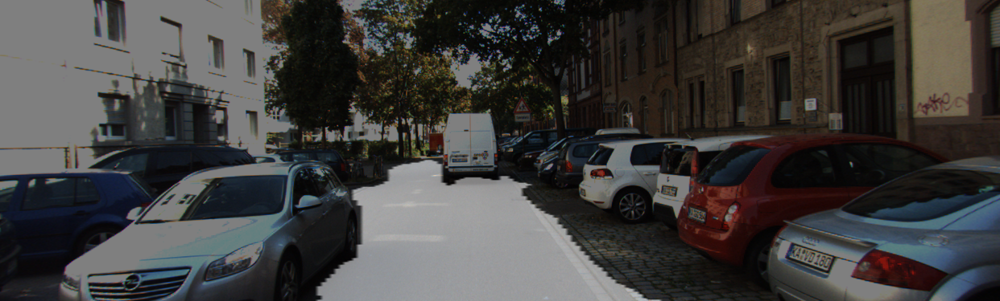

IoU : 0.903088


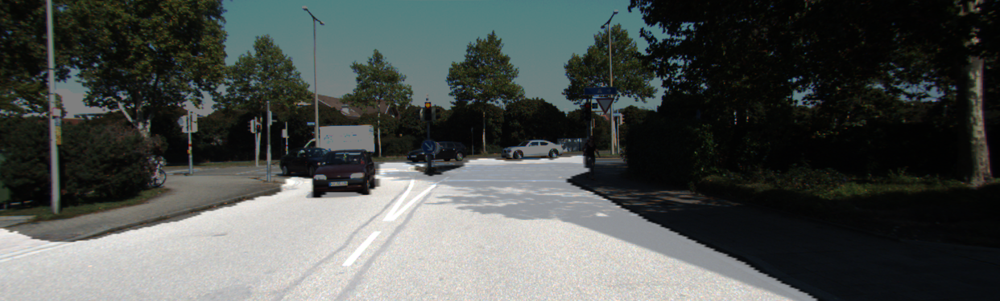

IoU : 0.949203


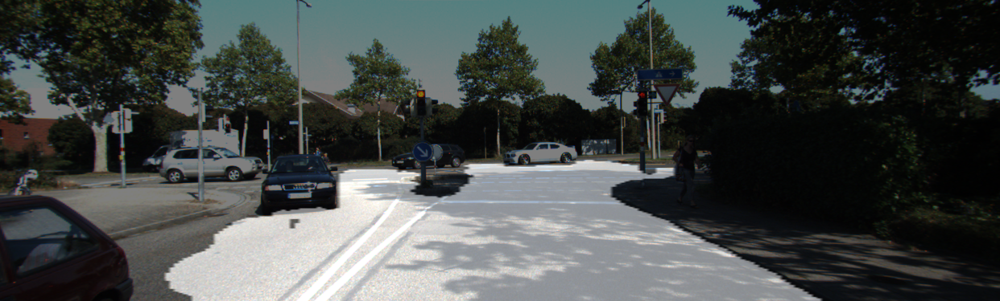

IoU : 0.860265


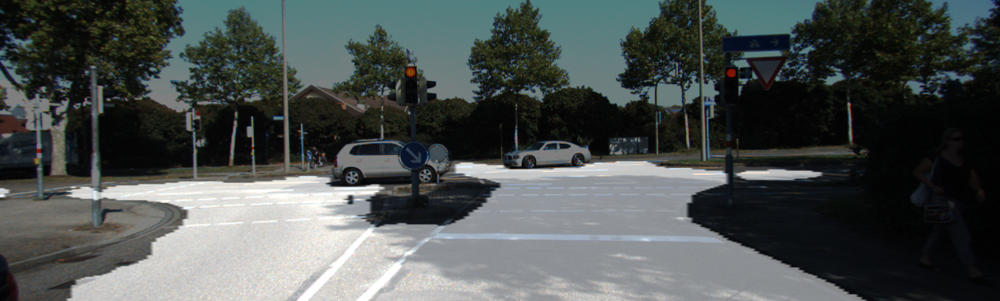

IoU : 0.870600


In [21]:
test(unet, test_preproc)

### UNet++ 구현

In [9]:
def build_unetplusplus(input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)):
    inputs = Input(input_shape)

    #Contracting Path
    conv0_0 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(inputs)
    pool_0 = MaxPooling2D((2, 2))(conv0_0)

    conv1_0 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool_0)
    conv0_1 = UpSampling2D((2, 2))(conv1_0)
    conv0_1 = tf.concat([conv0_1, conv0_0], axis=3)
    pool_1 = MaxPooling2D((2, 2))(conv1_0)
    
    conv2_0 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool_1)
    conv1_1 = UpSampling2D((2, 2))(conv2_0)
    conv1_1 = tf.concat([conv1_1, conv1_0], axis=3)
    conv0_2 = UpSampling2D((2, 2))(conv1_1)
    conv0_2 = tf.concat([conv0_2, conv0_1, conv0_0], axis=3)
    pool_2 = MaxPooling2D((2, 2))(conv2_0)
    
    conv3_0 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool_2)
    conv2_1 = UpSampling2D((2, 2))(conv3_0)
    conv2_1 = tf.concat([conv2_1, conv2_0], axis=3)
    conv1_2 = UpSampling2D((2, 2))(conv2_1)
    conv1_2 = tf.concat([conv1_2, conv1_1, conv1_0], axis=3)
    conv0_3 = UpSampling2D((2, 2))(conv1_2)
    conv0_3 = tf.concat([conv0_3, conv0_2, conv0_0], axis=3)
    pool_3 = MaxPooling2D((2, 2))(conv3_0)
    
    conv4_0 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool_3)
    
    conv3_1 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(UpSampling2D((2, 2))(conv4_0))
    conv3_1 = tf.concat([conv3_1, conv3_0], axis=3)
    
    conv2_2 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(UpSampling2D((2, 2))(conv3_1))
    conv2_2 = tf.concat([conv2_2, conv2_1, conv2_0], axis=3)
    
    conv1_3 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(UpSampling2D((2, 2))(conv2_2))
    conv1_3 = tf.concat([conv1_3, conv1_2, conv1_0], axis=3)
    
    conv0_4 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(UpSampling2D((2, 2))(conv1_3))
    conv0_4 = tf.concat([conv0_4, conv0_3, conv0_0], axis=3)

    output = Conv2D(1, 1, activation='sigmoid')(conv0_4)

    model = Model(inputs = inputs, outputs = output)
    return model

In [10]:
unetpp = build_unetplusplus()

In [29]:
unetpp.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_34 (Conv2D)              (None, 224, 224, 64) 1792        input_3[0][0]                    
__________________________________________________________________________________________________
max_pooling2d_8 (MaxPooling2D)  (None, 112, 112, 64) 0           conv2d_34[0][0]                  
__________________________________________________________________________________________________
conv2d_35 (Conv2D)              (None, 112, 112, 128 73856       max_pooling2d_8[0][0]            
____________________________________________________________________________________________

## UNet++ 모델 학습

In [30]:
unetpp_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/0314_seg_model_unetpp.h5'

unetpp.compile(optimizer = Adam(LEARNING_RATE), loss = 'binary_crossentropy')

unetpp_history = unetpp.fit(
     train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=EPOCH,
 )

unetpp.save(unetpp_path)

Epoch 1/150
170/170 [==============================] - 32s 163ms/step - loss: 0.4178 - val_loss: 0.5013
Epoch 2/150
170/170 [==============================] - 28s 163ms/step - loss: 0.2930 - val_loss: 0.3541
Epoch 3/150
170/170 [==============================] - 28s 165ms/step - loss: 0.2526 - val_loss: 0.2627
Epoch 4/150
170/170 [==============================] - 29s 168ms/step - loss: 0.2224 - val_loss: 0.2781
Epoch 5/150
170/170 [==============================] - 29s 168ms/step - loss: 0.1974 - val_loss: 0.2774
Epoch 6/150
170/170 [==============================] - 28s 167ms/step - loss: 0.2135 - val_loss: 0.2685
Epoch 7/150
170/170 [==============================] - 29s 168ms/step - loss: 0.1908 - val_loss: 0.5046
Epoch 8/150
170/170 [==============================] - 29s 168ms/step - loss: 0.2069 - val_loss: 0.2750
Epoch 9/150
170/170 [==============================] - 28s 167ms/step - loss: 0.1862 - val_loss: 0.2279
Epoch 10/150
170/170 [==============================] - 28s 167m

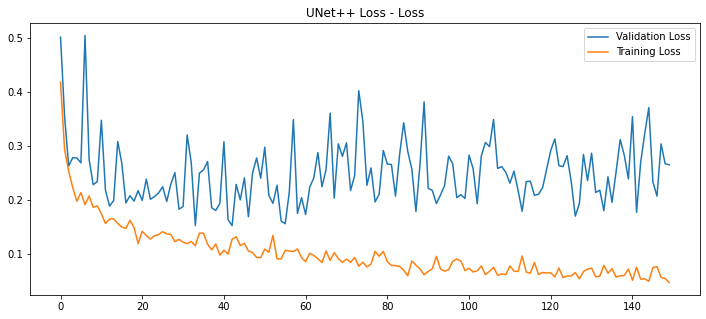

In [31]:
visualize_history(unetpp_history, "UNet++ Loss")

In [32]:
unetpp_history_csv_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/history/0314_unetpp_history.csv'
save_history_to_csv_path(unetpp_history, unetpp_history_csv_path)

## 모델 성능 비교

In [33]:
def visualize_histories(info_histories):
    plt.figure(figsize=(12, 5))
    
    num_of_histories = len(info_histories)
    for i, info_history in enumerate(info_histories):
        history = info_history['history']
        title = info_history['title']
        
        # Plot loss
        plt.plot(history.history['val_loss'], label=title+' Validation Loss')
        # plt.plot(history.history['loss'], label=title+' Training Loss')
        plt.title(f'{title} - Loss')
        plt.legend()

    plt.show()

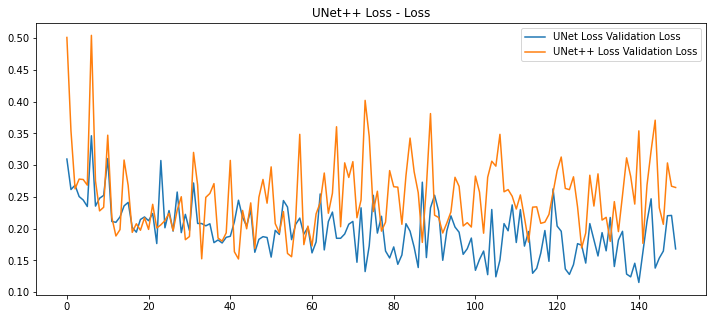

In [34]:
visualize_histories([
    {'history': unet_history, 'title': "UNet Loss"},
    {'history': unetpp_history, 'title': "UNet++ Loss"},
])

In [11]:
unet_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/0314_seg_model_unet.h5'
unet = tf.keras.models.load_model(unet_path)

unetpp_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/0314_seg_model_unetpp.h5'
unetpp = tf.keras.models.load_model(unetpp_path)

In [18]:
def test_iou(model, dataset):
    ious = []
    for i in range(1, 20):
        output, prediction, target = get_output(
            model, 
            dataset,
            image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
            output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
            label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
        )
        iou = calculate_iou_score(target, prediction)
        ious.append(iou)
    return ious

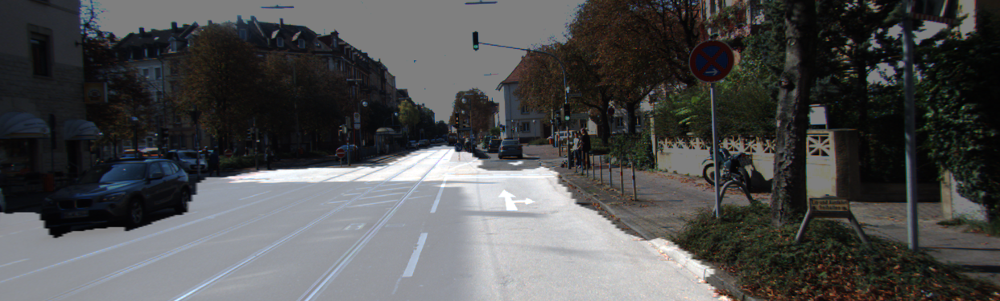

IoU : 0.946310


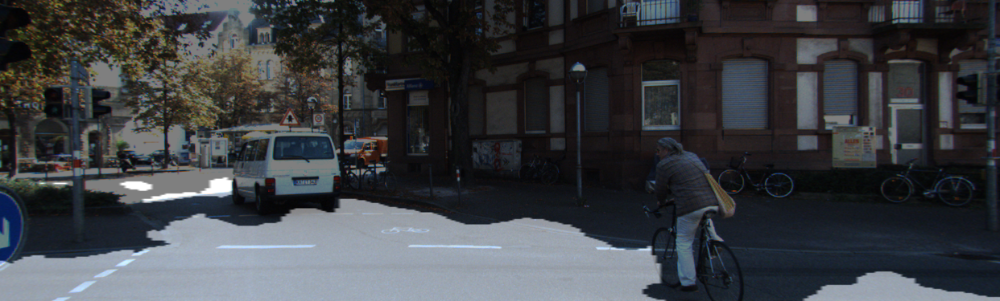

IoU : 0.704666


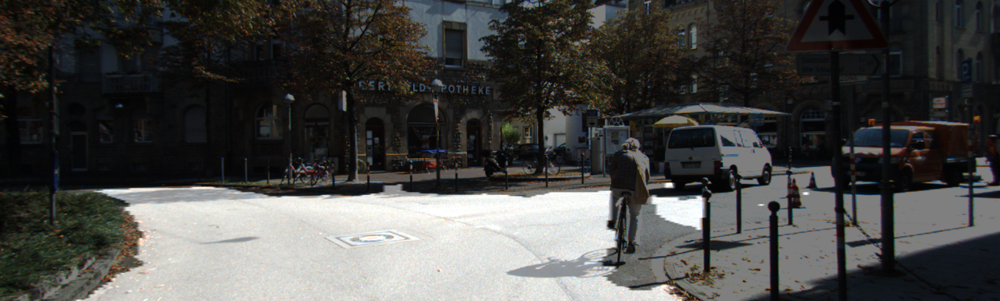

IoU : 0.814805


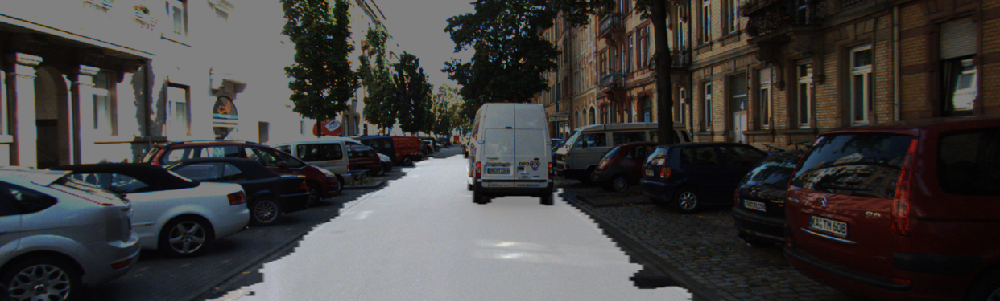

IoU : 0.912438


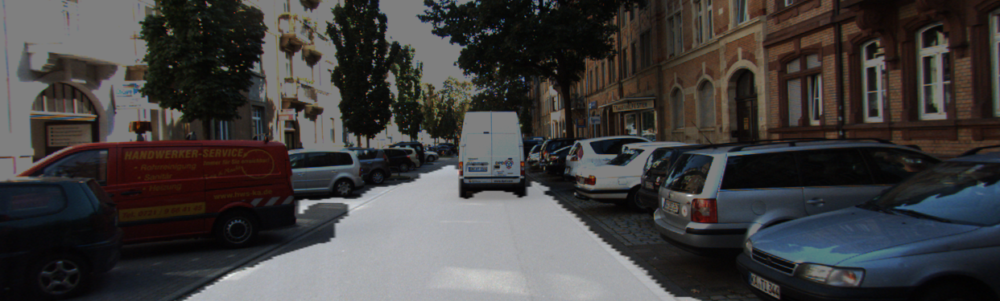

IoU : 0.925781


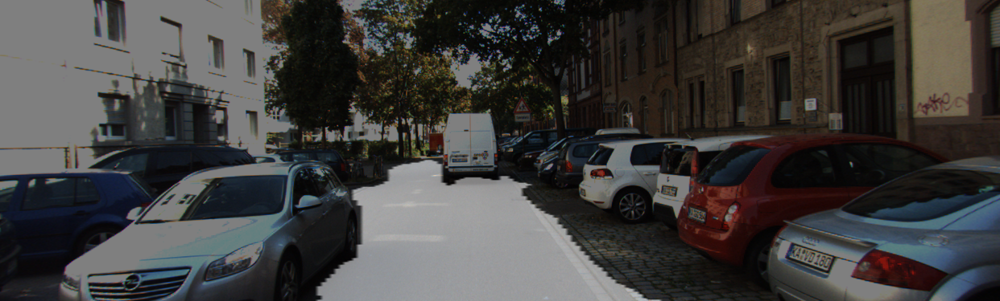

IoU : 0.903088


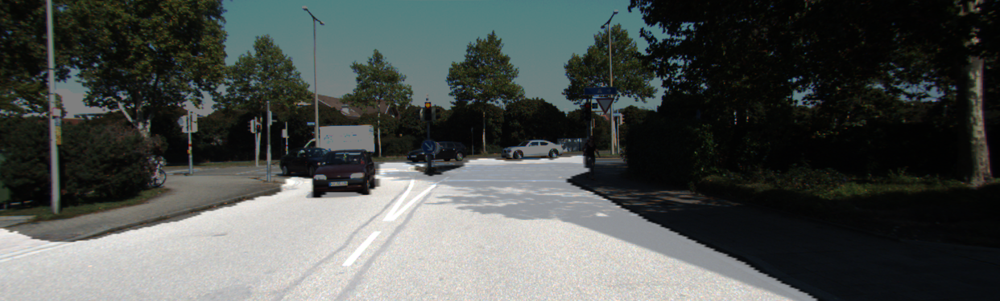

IoU : 0.949203


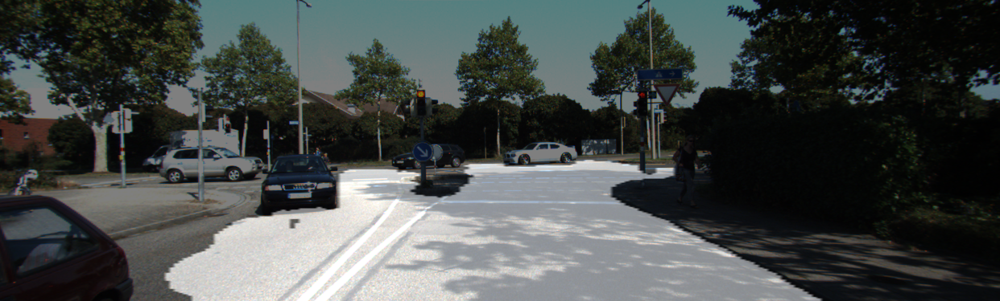

IoU : 0.860265


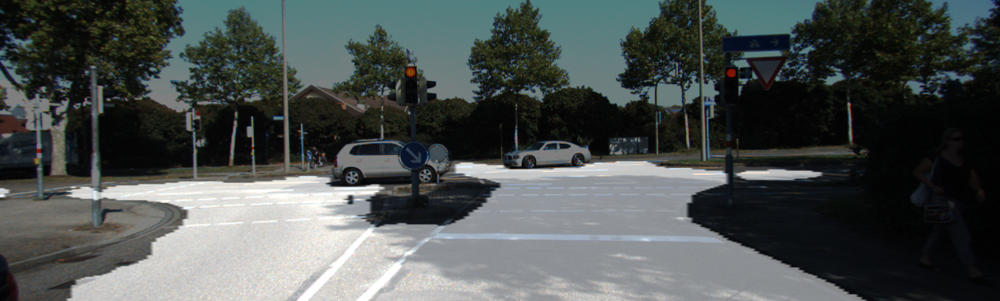

IoU : 0.870600


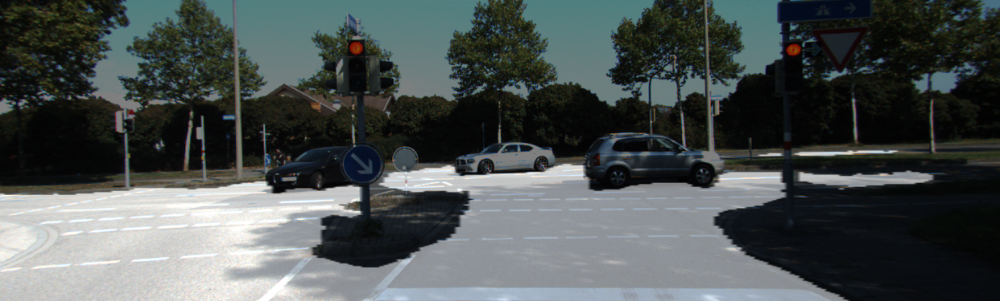

IoU : 0.882907


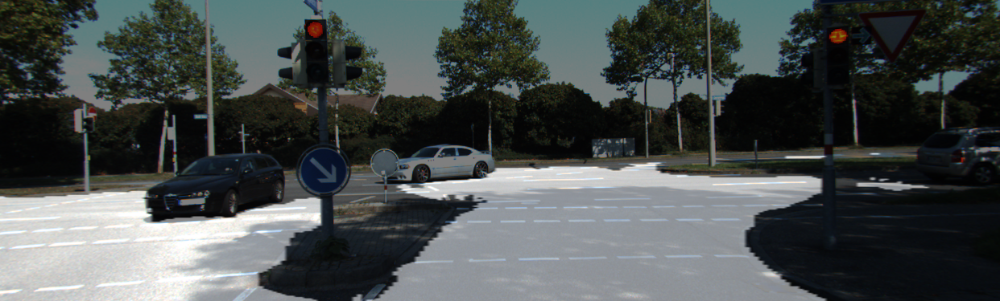

IoU : 0.864052


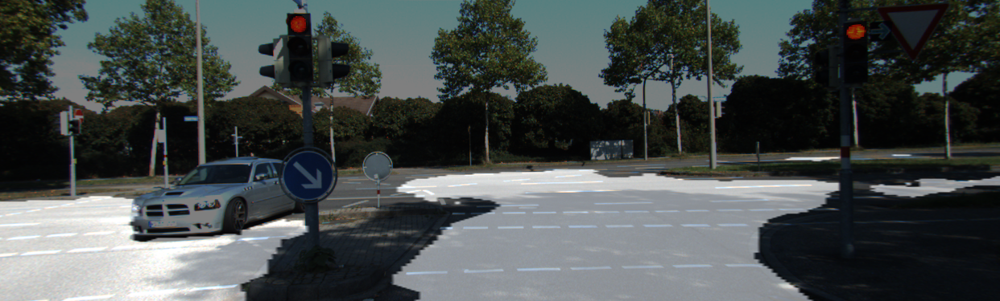

IoU : 0.838601


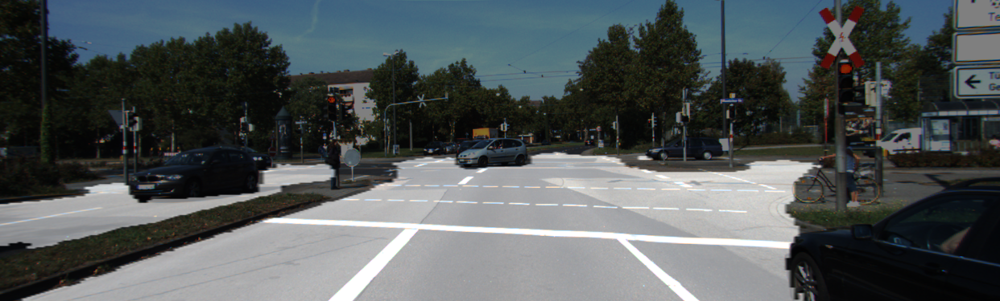

IoU : 0.910365


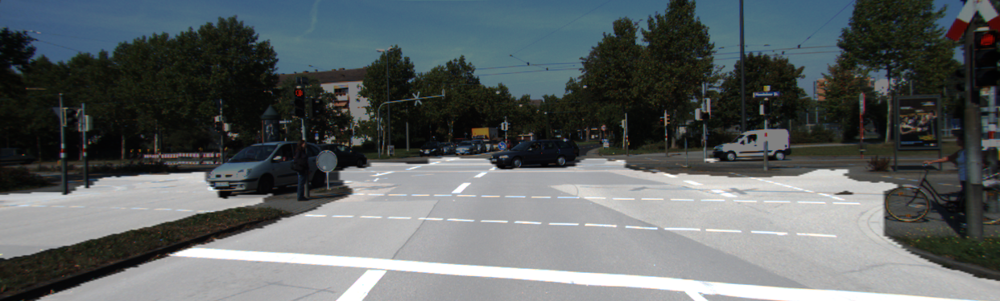

IoU : 0.910759


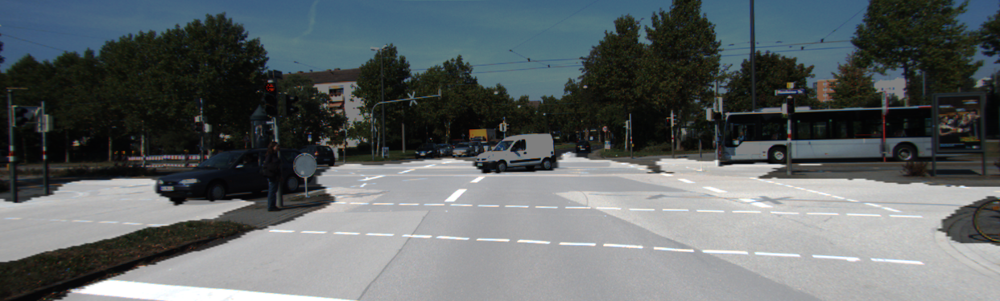

IoU : 0.922034


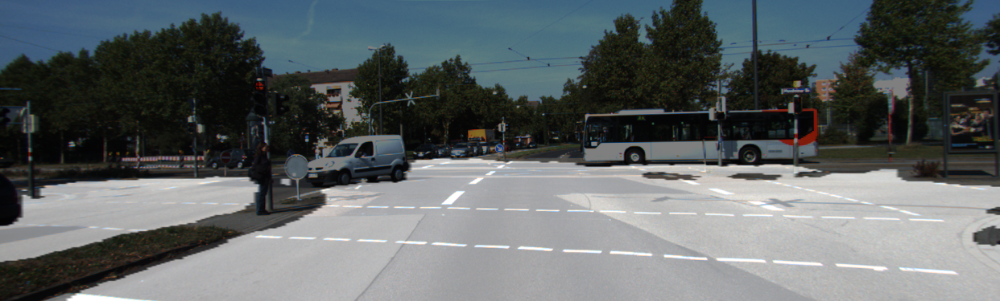

IoU : 0.916671


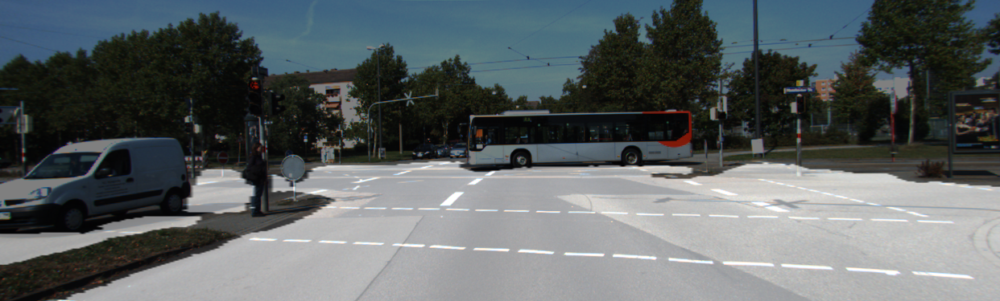

IoU : 0.921236


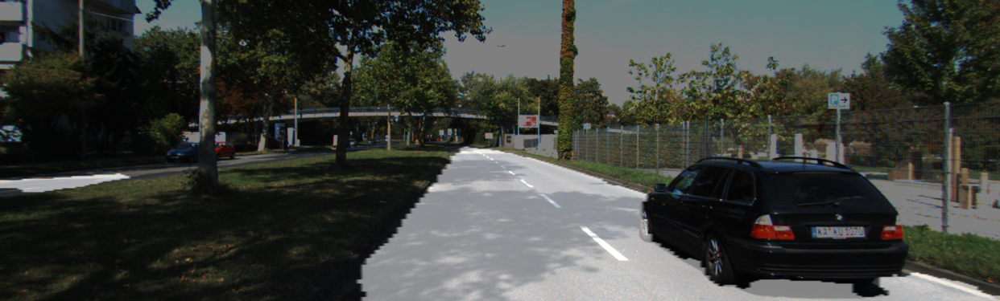

IoU : 0.879532


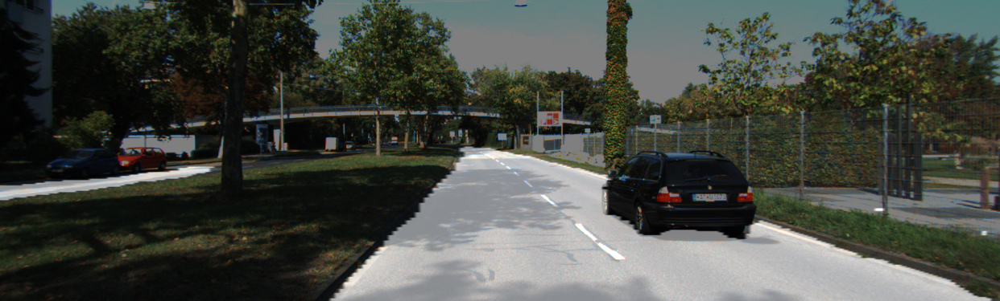

IoU : 0.942064


In [19]:
unet_ious = test_iou(unet, test_preproc)

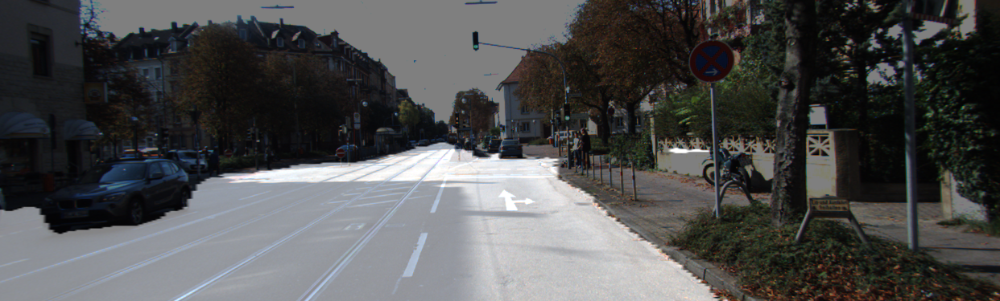

IoU : 0.964880


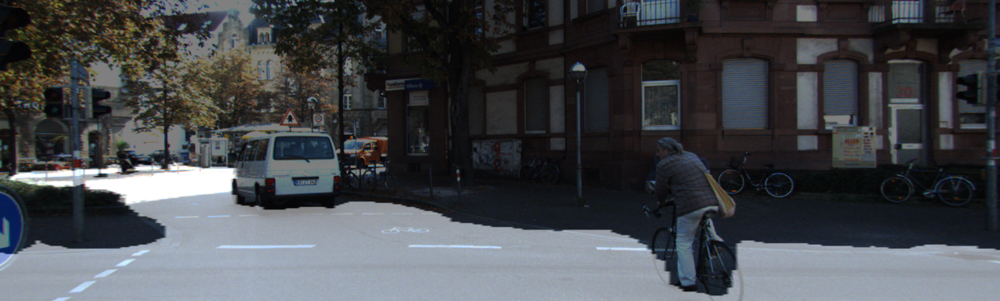

IoU : 0.896979


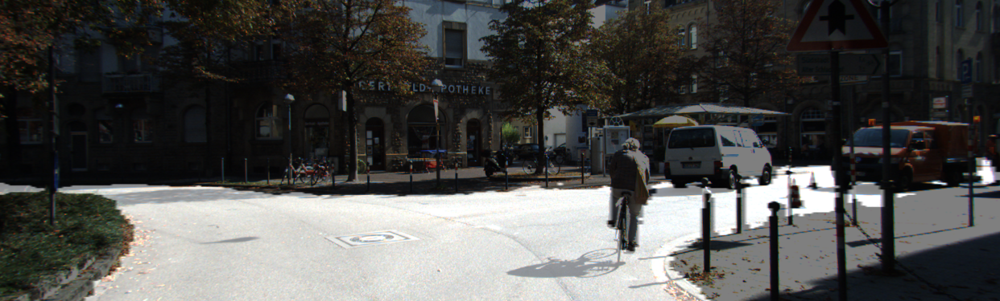

IoU : 0.912611


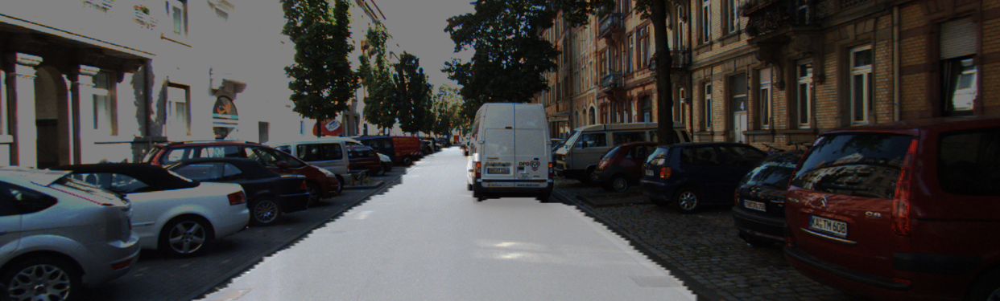

IoU : 0.954908


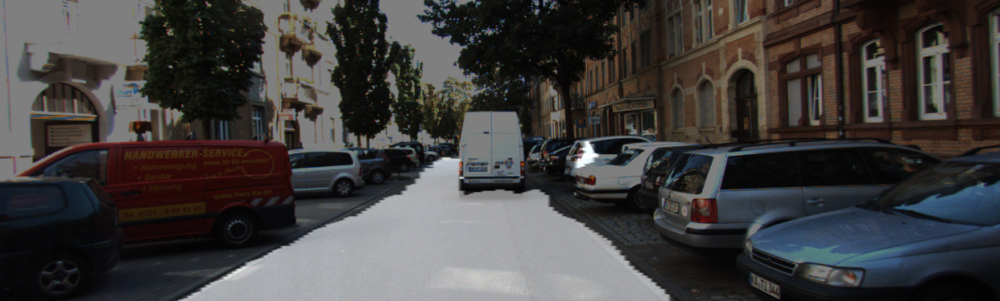

IoU : 0.952889


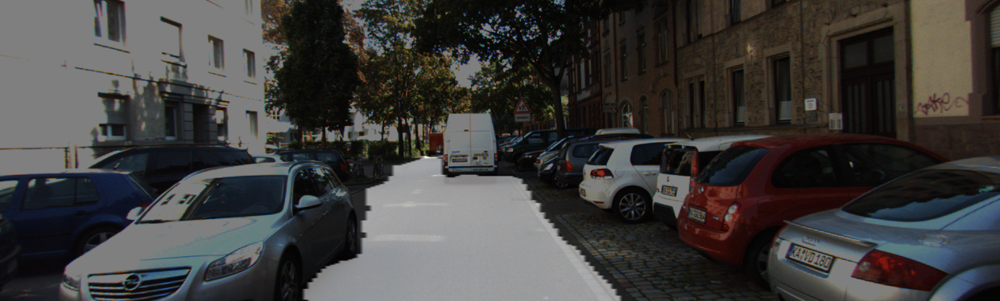

IoU : 0.935243


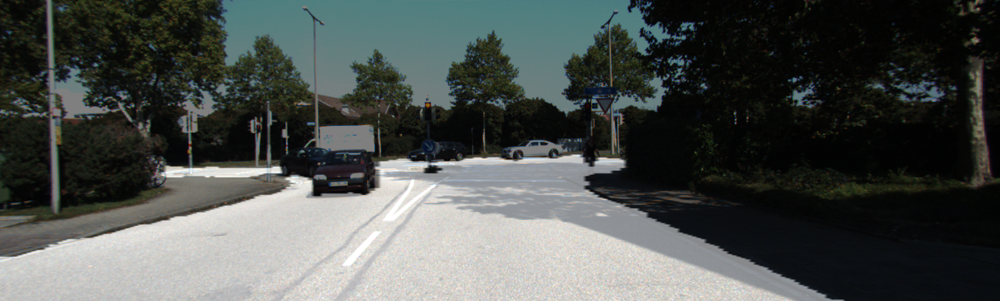

IoU : 0.960311


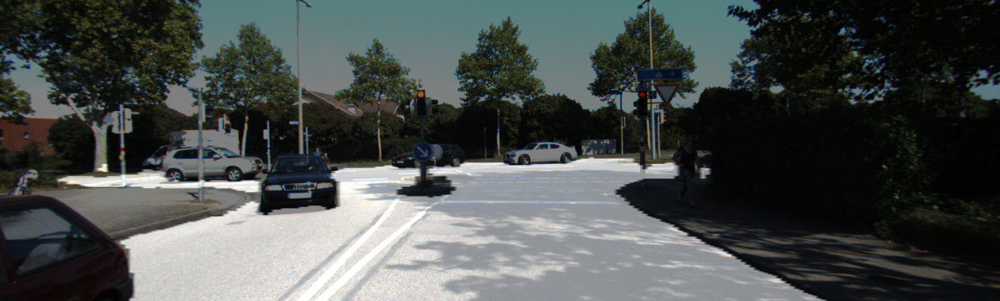

IoU : 0.949701


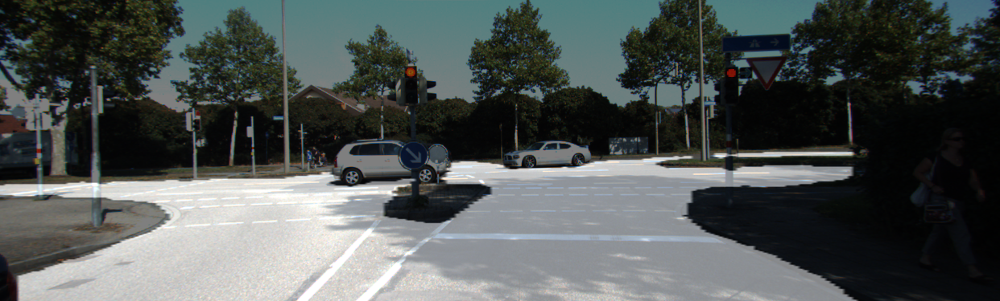

IoU : 0.959405


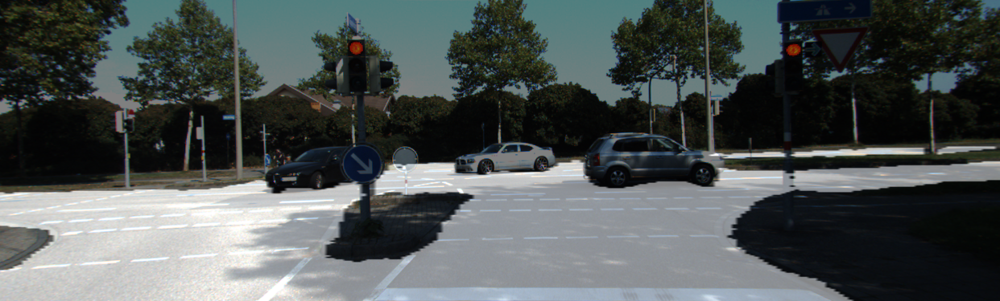

IoU : 0.923457


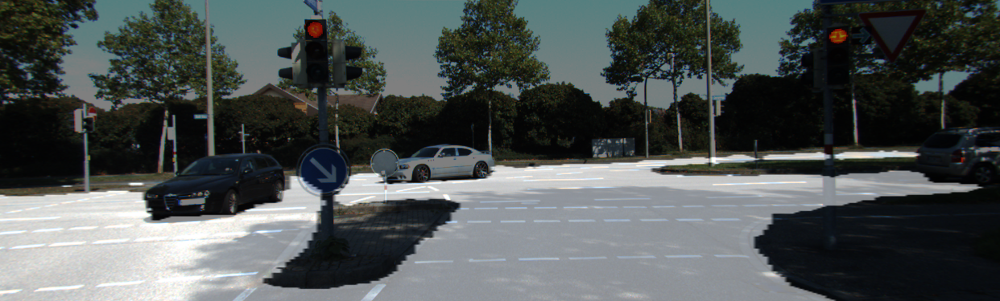

IoU : 0.938966


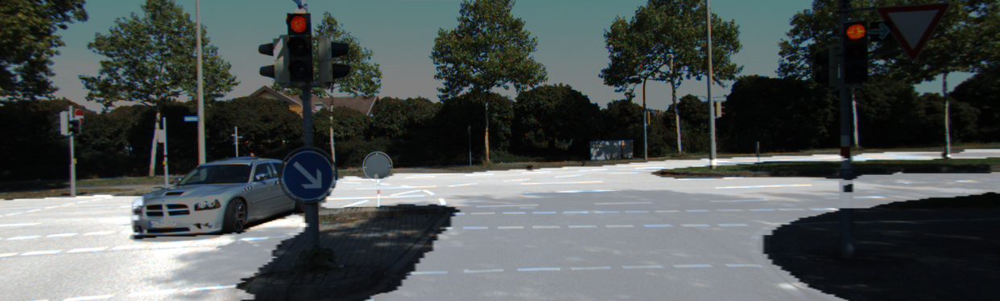

IoU : 0.927831


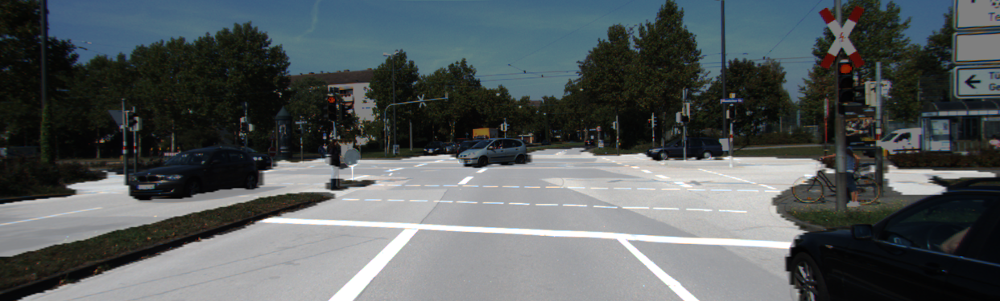

IoU : 0.950149


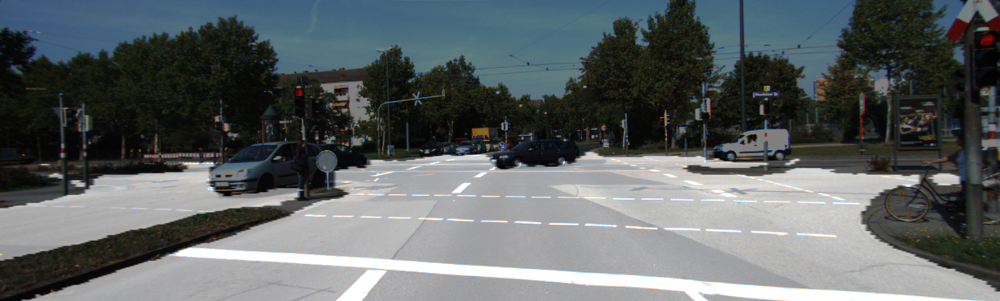

IoU : 0.943828


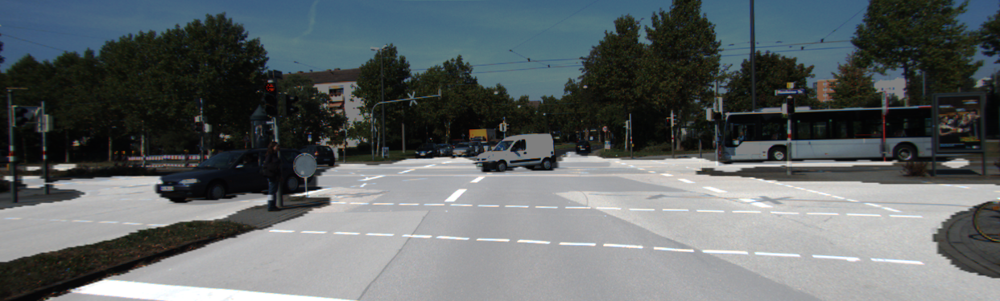

IoU : 0.947210


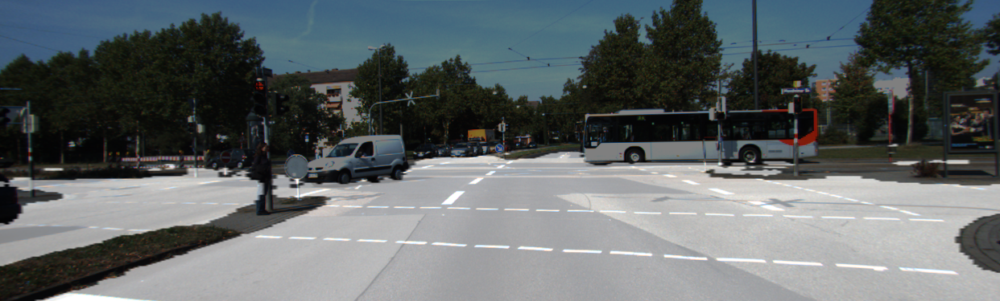

IoU : 0.946024


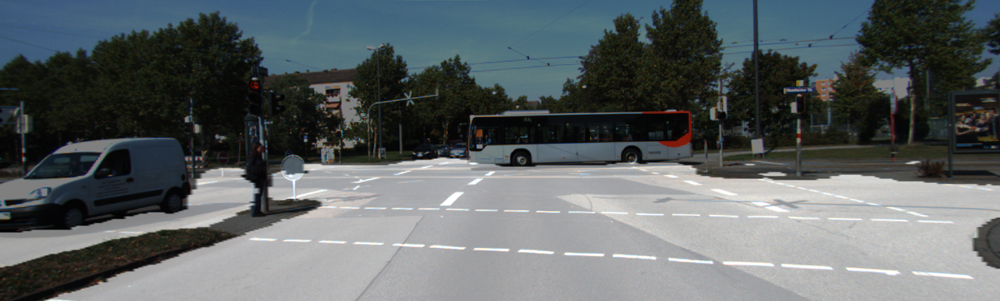

IoU : 0.946339


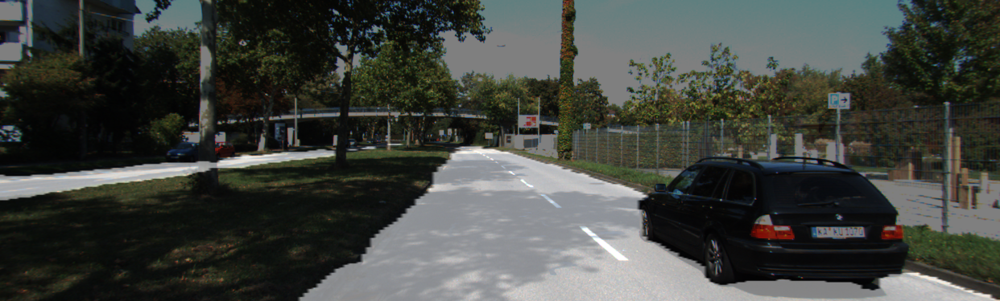

IoU : 0.914248


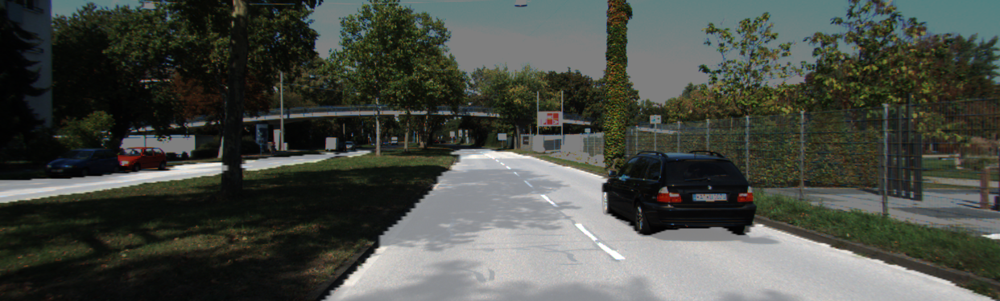

IoU : 0.942638


In [20]:
unetpp_ious = test_iou(unetpp, test_preproc)

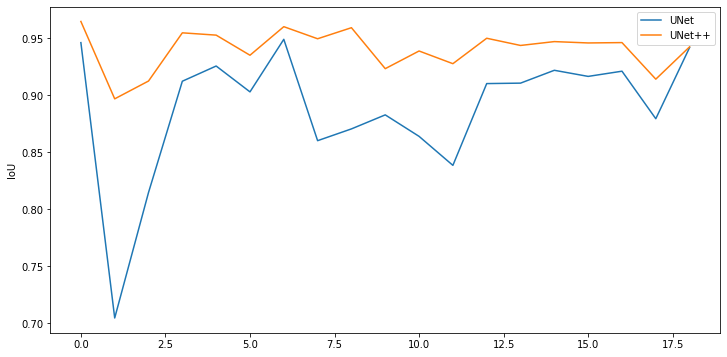

In [21]:
plt.figure(figsize=(12, 6))
plt.plot(unet_ious, label='UNet')
plt.plot(unetpp_ious, label='UNet++')
plt.ylabel('IoU')
plt.legend()

### 회고
- UNet은 비교적 구현이 쉬웠는데 UNet++는 nested connection이 조금 어려웠음
- 처음에 UNet을 배치 크기 32로 돌렸었는데 UNet++는 OOM 나서 16으로 줄임
  ![oom](./images/oom.png)  
- 정량적으로 비교가 잘 안 돼서 for loop 안 쓰고 모델을 다시 구현해서 비교 ㅠㅠ
- 정성적으로 보면 테스트에서 두 번째와 세 번째 이미지가 눈에 띄게 비교가 됨  
  ![unet1](./images/unet1.png) ![unetpp1](./images/unetpp1.png)  
  - 그림자 경계선도 길로 잘 인식이 됨  
  ![unet2](./images/unet2.png) ![unetpp2](./images/unetpp2.png)  
  - 길쭉해서 가로로 스케일이 작은데도 인식이 됨  
- 정량적으로 IoU 그래프를 그려보았는데, UNet++가 더 높은 성능을 보임
